In [1]:
import pandas as pd

# Load the dataset
file_path = 'hotel_booking.csv'
df = pd.read_csv(file_path)

print(df.info())
print(df.describe())
print(df.head())


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119390 entries, 0 to 119389
Data columns (total 36 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   hotel                           119390 non-null  object 
 1   is_canceled                     119390 non-null  int64  
 2   lead_time                       119390 non-null  int64  
 3   arrival_date_year               119390 non-null  int64  
 4   arrival_date_month              119390 non-null  object 
 5   arrival_date_week_number        119390 non-null  int64  
 6   arrival_date_day_of_month       119390 non-null  int64  
 7   stays_in_weekend_nights         119390 non-null  int64  
 8   stays_in_week_nights            119390 non-null  int64  
 9   adults                          119390 non-null  int64  
 10  children                        119386 non-null  float64
 11  babies                          119390 non-null  int64  
 12  meal            

In [2]:
df['total_stays'] = df['stays_in_weekend_nights'] + df['stays_in_week_nights']


In [3]:
df['booking_year_month'] = df['arrival_date_year'].astype(str) + '-' + df['arrival_date_month'].astype(str)


In [4]:
# Mapping month names to their corresponding numerical values
month_mapping = {'January': 1, 'February': 2, 'March': 3, 'April': 4, 'May': 5, 'June': 6, 
                 'July': 7, 'August': 8, 'September': 9, 'October': 10, 'November': 11, 'December': 12}
df['arrival_date_month'] = df['arrival_date_month'].map(month_mapping)

df['arrival_date_year'] = df['arrival_date_year'].astype(int)
df['arrival_date_month'] = df['arrival_date_month'].astype(int)
df['arrival_date_day_of_month'] = df['arrival_date_day_of_month'].astype(int)
df['lead_time'] = df['lead_time'].astype(int)

df = df.drop_duplicates()


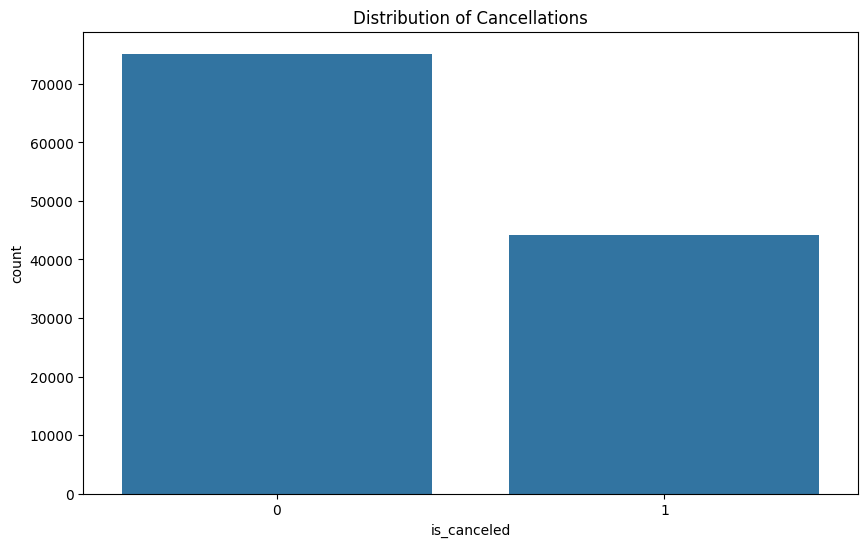

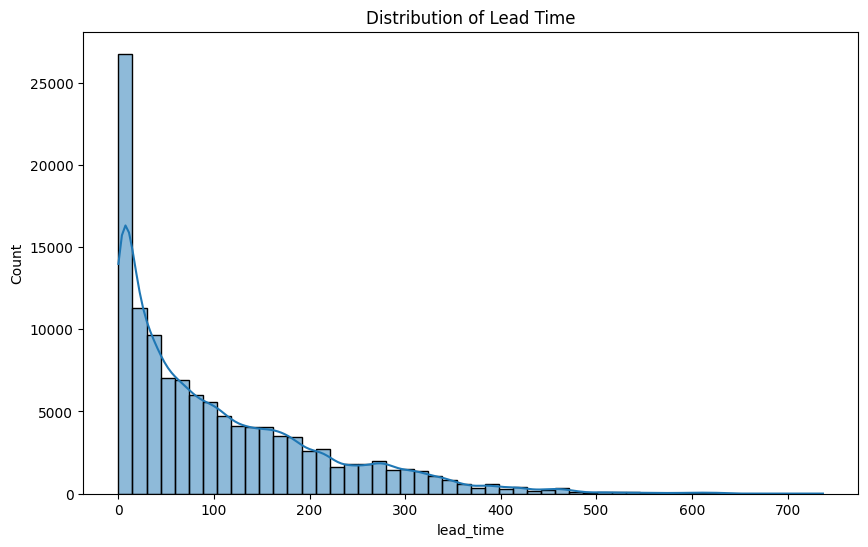

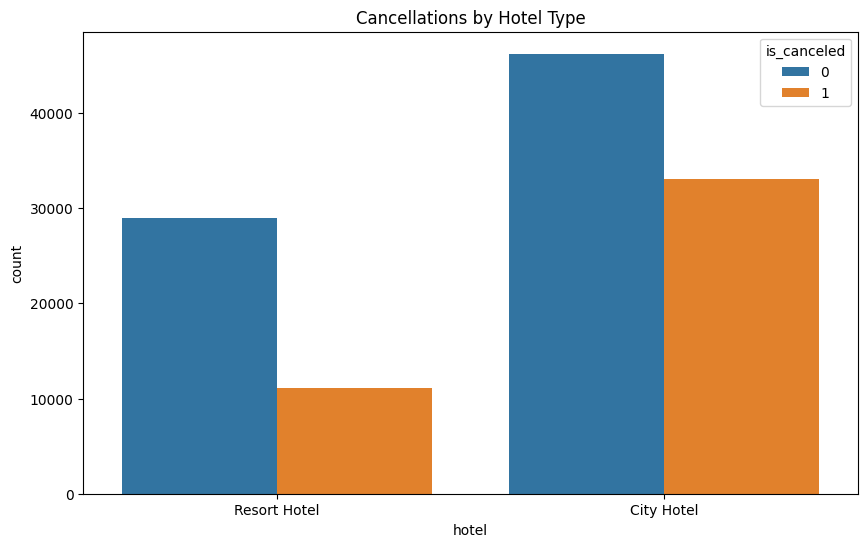

In [5]:
import matplotlib.pyplot as plt
import seaborn as sns


plt.figure(figsize=(10, 6))
sns.countplot(x='is_canceled', data=df)
plt.title('Distribution of Cancellations')
plt.show()


plt.figure(figsize=(10, 6))
sns.histplot(df['lead_time'], bins=50, kde=True)
plt.title('Distribution of Lead Time')
plt.show()


plt.figure(figsize=(10, 6))
sns.countplot(x='hotel', hue='is_canceled', data=df)
plt.title('Cancellations by Hotel Type')
plt.show()


In [6]:
print(df[['lead_time', 'total_stays', 'adults', 'children', 'babies']].describe())


           lead_time    total_stays         adults       children  \
count  119390.000000  119390.000000  119390.000000  119386.000000   
mean      104.011416       3.427900       1.856403       0.103890   
std       106.863097       2.557439       0.579261       0.398561   
min         0.000000       0.000000       0.000000       0.000000   
25%        18.000000       2.000000       2.000000       0.000000   
50%        69.000000       3.000000       2.000000       0.000000   
75%       160.000000       4.000000       2.000000       0.000000   
max       737.000000      69.000000      55.000000      10.000000   

              babies  
count  119390.000000  
mean        0.007949  
std         0.097436  
min         0.000000  
25%         0.000000  
50%         0.000000  
75%         0.000000  
max        10.000000  


In [8]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
df[['lead_time', 'total_stays']] = scaler.fit_transform(df[['lead_time', 'total_stays']])


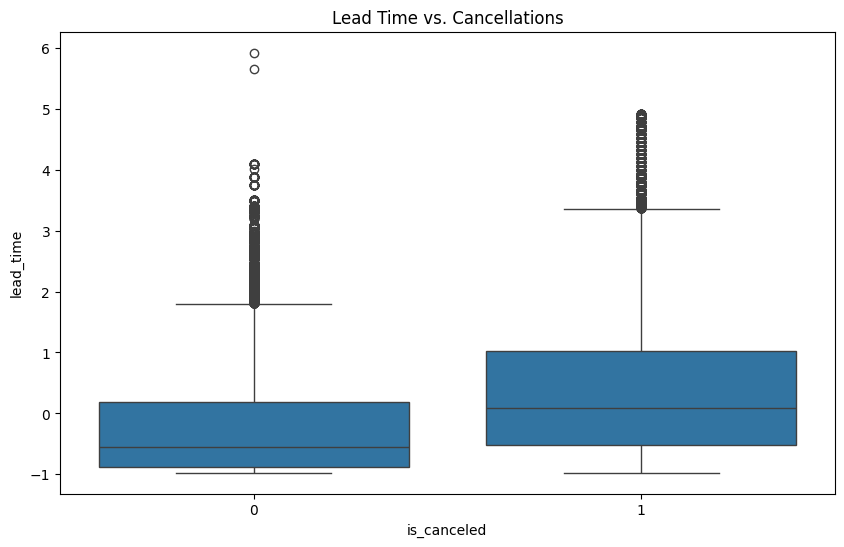

In [9]:

plt.figure(figsize=(10, 6))
sns.boxplot(x='is_canceled', y='lead_time', data=df)
plt.title('Lead Time vs. Cancellations')
plt.show()


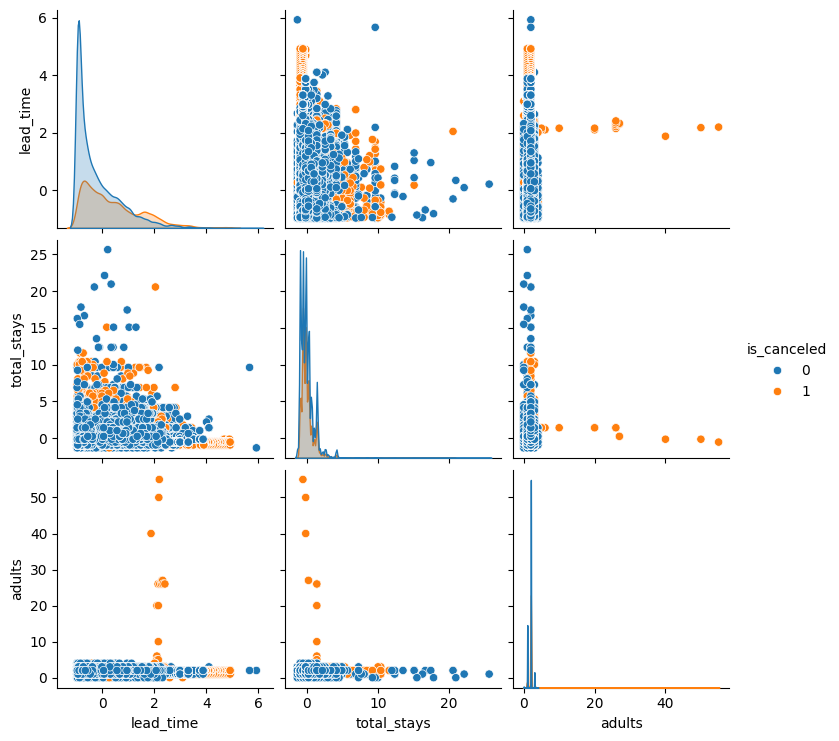

In [10]:

sns.pairplot(df[['lead_time', 'total_stays', 'adults', 'is_canceled']], hue='is_canceled')
plt.show()


In [11]:

# Season
def get_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    else:
        return 'Autumn'

df['season'] = df['arrival_date_month'].apply(get_season)


df['total_guests'] = df['adults'] + df['children'] + df['babies']

# Weekend Stays vs. Weekday Stays Ratio
df['weekend_to_weekday_ratio'] = df['stays_in_weekend_nights'] / (df['stays_in_week_nights'] + 1)  # Add 1 to avoid division by zero


In [12]:
import plotly.express as px
import plotly.graph_objects as go


fig1 = px.histogram(df, x='hotel', color='is_canceled', barmode='group', title='Cancellations by Hotel Type')
fig1.show()


fig2 = px.histogram(df, x='lead_time', nbins=50, title='Lead Time Distribution')
fig2.show()


fig3 = px.histogram(df, x='season', color='is_canceled', barmode='group', title='Seasonal Trends in Bookings')
fig3.show()


fig4 = px.histogram(df, x='total_guests', nbins=50, title='Total Guests Distribution')
fig4.show()


fig5 = px.histogram(df, x='weekend_to_weekday_ratio', nbins=50, title='Weekend to Weekday Stay Ratio')
fig5.show()


In [13]:
import pandas as pd

# Load the dataset
file_path = 'hotel_booking.csv'
df = pd.read_csv(file_path)

# Mapping month names to their corresponding numerical values
month_mapping = {'January': 1, 'February': 2, 'March': 3, 'April': 4, 'May': 5, 'June': 6, 
                 'July': 7, 'August': 8, 'September': 9, 'October': 10, 'November': 11, 'December': 12}
df['arrival_date_month'] = df['arrival_date_month'].map(month_mapping)

# Correcting data types
df['arrival_date_year'] = df['arrival_date_year'].astype(int)
df['arrival_date_month'] = df['arrival_date_month'].astype(int)
df['arrival_date_day_of_month'] = df['arrival_date_day_of_month'].astype(int)
df['lead_time'] = df['lead_time'].astype(int)

# Removing duplicates
df = df.drop_duplicates()

# Feature Engineering
# Season
def get_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    else:
        return 'Autumn'

df['season'] = df['arrival_date_month'].apply(get_season)

# Total Guests
df['total_guests'] = df['adults'] + df['children'] + df['babies']

# Weekend Stays vs. Weekday Stays Ratio
df['weekend_to_weekday_ratio'] = df['stays_in_weekend_nights'] / (df['stays_in_week_nights'] + 1)  # Add 1 to avoid division by zero

# Booking Month
df['reservation_status_date'] = pd.to_datetime(df['reservation_status_date'])
df['booking_month'] = df['reservation_status_date'].dt.month

# Stay Duration
df['stay_duration'] = df['stays_in_weekend_nights'] + df['stays_in_week_nights']

# Is Family
df['is_family'] = (df['adults'] > 1) | (df['children'] > 0) | (df['babies'] > 0)

# Is Long Stay
df['is_long_stay'] = df['stay_duration'] > 7

# Converting month_year to string format
df['month_year'] = df['reservation_status_date'].dt.to_period('M').astype(str)


In [14]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff

# Load the dataset
file_path = 'hotel_booking.csv'
df = pd.read_csv(file_path)

# Mapping month names to their corresponding numerical values
month_mapping = {'January': 1, 'February': 2, 'March': 3, 'April': 4, 'May': 5, 'June': 6, 
                 'July': 7, 'August': 8, 'September': 9, 'October': 10, 'November': 11, 'December': 12}
df['arrival_date_month'] = df['arrival_date_month'].map(month_mapping)

# Correcting data types
df['arrival_date_year'] = df['arrival_date_year'].astype(int)
df['arrival_date_month'] = df['arrival_date_month'].astype(int)
df['arrival_date_day_of_month'] = df['arrival_date_day_of_month'].astype(int)
df['lead_time'] = df['lead_time'].astype(int)

# Removing duplicates
df = df.drop_duplicates()

# Feature Engineering
# Season
def get_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    else:
        return 'Autumn'

df['season'] = df['arrival_date_month'].apply(get_season)

# Total Guests
df['total_guests'] = df['adults'] + df['children'] + df['babies']

# Weekend Stays vs. Weekday Stays Ratio
df['weekend_to_weekday_ratio'] = df['stays_in_weekend_nights'] / (df['stays_in_week_nights'] + 1)  # Add 1 to avoid division by zero

# Booking Month
df['reservation_status_date'] = pd.to_datetime(df['reservation_status_date'])
df['booking_month'] = df['reservation_status_date'].dt.month

# Stay Duration
df['stay_duration'] = df['stays_in_weekend_nights'] + df['stays_in_week_nights']

# Is Family
df['is_family'] = (df['adults'] > 1) | (df['children'] > 0) | (df['babies'] > 0)

# Is Long Stay
df['is_long_stay'] = df['stay_duration'] > 7

# Converting month_year to string format
df['month_year'] = df['reservation_status_date'].dt.to_period('M').astype(str)

# Bookings Over Time
fig6 = px.histogram(df, x='month_year', title='Bookings Over Time')
fig6.update_xaxes(categoryorder='category ascending')
fig6.show()

# Average Daily Rate (ADR) by Customer Type
fig7 = px.box(df, x='customer_type', y='adr', title='Average Daily Rate (ADR) by Customer Type')
fig7.show()

# Cancellation Rates by Country
cancellation_rate = df.groupby('country')['is_canceled'].mean().reset_index()
fig8 = px.choropleth(cancellation_rate, locations='country', locationmode='country names', color='is_canceled',
                     title='Cancellation Rates by Country')
fig8.show()

# Distribution of Stay Duration
fig9 = px.histogram(df, x='stay_duration', nbins=50, title='Distribution of Stay Duration')
fig9.show()

# Correlation Heatmap
numeric_df = df.select_dtypes(include=['int64', 'float64'])
corr = numeric_df.corr()
fig10 = ff.create_annotated_heatmap(
    z=corr.values,
    x=list(corr.columns),
    y=list(corr.index),
    annotation_text=corr.round(2).values,
    showscale=True,
    colorscale='Viridis'
)
fig10.update_layout(title='Correlation Heatmap')
fig10.show()

# Booking Trends by Market Segment
fig11 = px.histogram(df, x='market_segment', color='is_canceled', barmode='group', title='Booking Trends by Market Segment')
fig11.show()

# Cancellation Rates by Lead Time
fig12 = px.scatter(df, x='lead_time', y='is_canceled', title='Cancellation Rates by Lead Time')
fig12.show()

# Booking Changes Analysis
fig13 = px.histogram(df, x='booking_changes', title='Distribution of Booking Changes')
fig13.show()

# Impact of Special Requests on Cancellations
fig14 = px.box(df, x='total_of_special_requests', y='is_canceled', title='Impact of Special Requests on Cancellations')
fig14.show()

# Room Type vs. Assigned Room Type
fig15 = px.scatter(df, x='reserved_room_type', y='assigned_room_type', color='is_canceled', 
                   title='Room Type vs. Assigned Room Type')
fig15.show()


In [15]:
# Lead Time Category
def categorize_lead_time(days):
    if days <= 30:
        return 'Short'
    elif days <= 90:
        return 'Medium'
    else:
        return 'Long'

df['lead_time_category'] = df['lead_time'].apply(categorize_lead_time)

# Booking Weekday
df['reservation_status_weekday'] = df['reservation_status_date'].dt.day_name()

# Repeat Customer
df['is_repeat_customer'] = df['is_repeated_guest'].apply(lambda x: 'Yes' if x == 1 else 'No')

# Cancellation Rate per Hotel Type
cancellation_rate_per_hotel = df.groupby('hotel')['is_canceled'].mean().reset_index()
cancellation_rate_per_hotel.columns = ['hotel', 'cancellation_rate']
df = df.merge(cancellation_rate_per_hotel, on='hotel', how='left')


In [16]:
import plotly.express as px
import plotly.figure_factory as ff

# Lead Time Distribution by Booking Status
fig16 = px.histogram(df, x='lead_time', color='is_canceled', title='Lead Time Distribution by Booking Status', barmode='overlay')
fig16.show()

# Cancellation Rate by Season
season_cancellation = df.groupby('season')['is_canceled'].mean().reset_index()
fig17 = px.bar(season_cancellation, x='season', y='is_canceled', title='Cancellation Rate by Season')
fig17.show()

# Booking Trend by Weekday
weekday_bookings = df['reservation_status_weekday'].value_counts().reset_index()
weekday_bookings.columns = ['weekday', 'count']
fig18 = px.bar(weekday_bookings, x='weekday', y='count', title='Booking Trend by Weekday', category_orders={'weekday': ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']})
fig18.show()

# Average Daily Rate by Room Type
fig19 = px.box(df, x='reserved_room_type', y='adr', title='Average Daily Rate by Room Type')
fig19.show()

# Cancellation Rate by Customer Type
customer_type_cancellation = df.groupby('customer_type')['is_canceled'].mean().reset_index()
fig20 = px.bar(customer_type_cancellation, x='customer_type', y='is_canceled', title='Cancellation Rate by Customer Type')
fig20.show()

# Total Guests Distribution
fig21 = px.histogram(df, x='total_guests', title='Total Guests Distribution', nbins=30)
fig21.show()

# Impact of Deposit Type on Cancellations
fig22 = px.box(df, x='deposit_type', y='is_canceled', title='Impact of Deposit Type on Cancellations')
fig22.show()
